In [ ]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline
from google.colab.patches import cv2_imshow
import numpy as np


In [ ]:
#Read Image
img1 = cv2.imread('/content/watch_1.jpg')
img2 = cv2.imread('/content/watch_2.jpg')

In [ ]:
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)

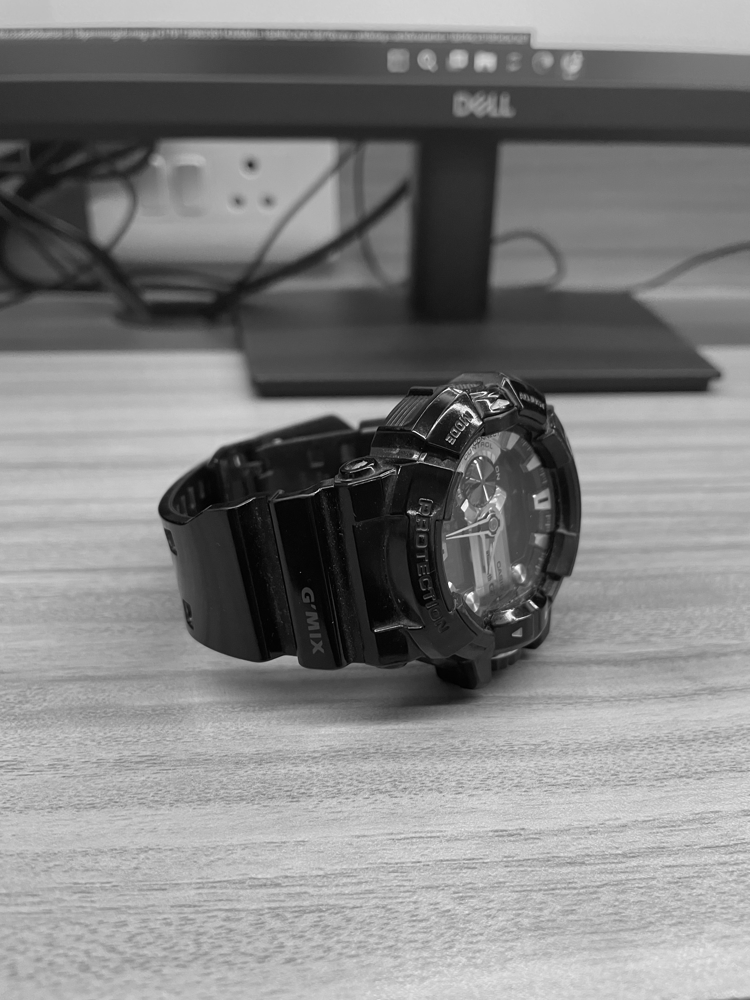

In [ ]:
cv2_imshow(img1)

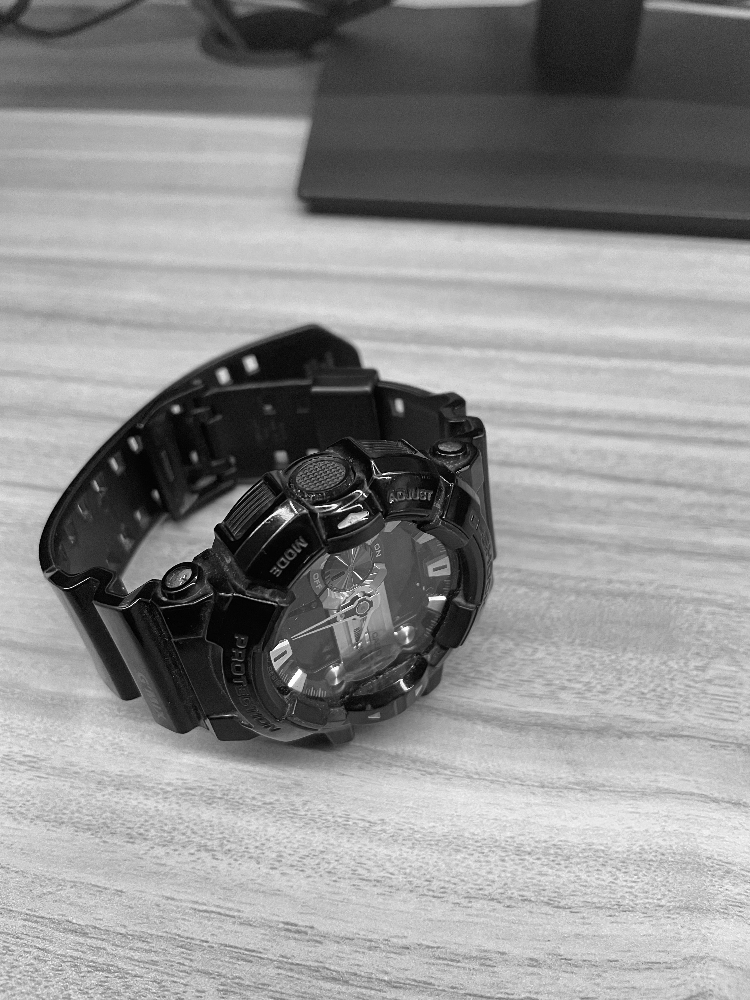

In [ ]:
cv2_imshow(img2)

In [ ]:
sift = cv2.xfeatures2d.SIFT_create()

In [ ]:
keypoints_1,descriptors_1 = sift.detectAndCompute(img1,None)
keypoints_2,descriptors_2 = sift.detectAndCompute(img2,None)

len(keypoints_1), len(keypoints_2)

(14611, 14739)

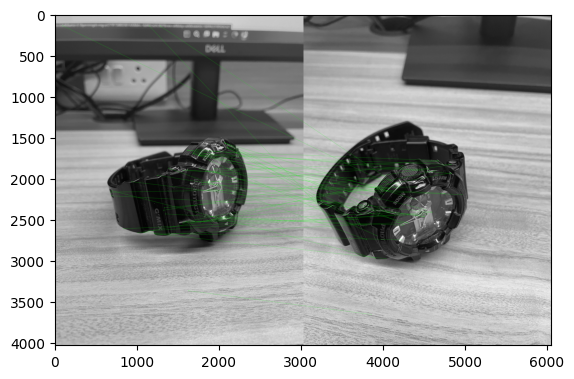

(<matplotlib.image.AxesImage at 0x7819044d9f00>, None)

In [ ]:
#Features Matching

bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1, descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img1, keypoints_1, img2, keypoints_2, matches[:50], img2, flags=2, matchColor=(0,255,0))
plt.imshow(img3), plt.show()

In [ ]:
#Extract matched keypoints

src_pts = np.float32([keypoints_1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
dst_pts = np.float32([keypoints_2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)


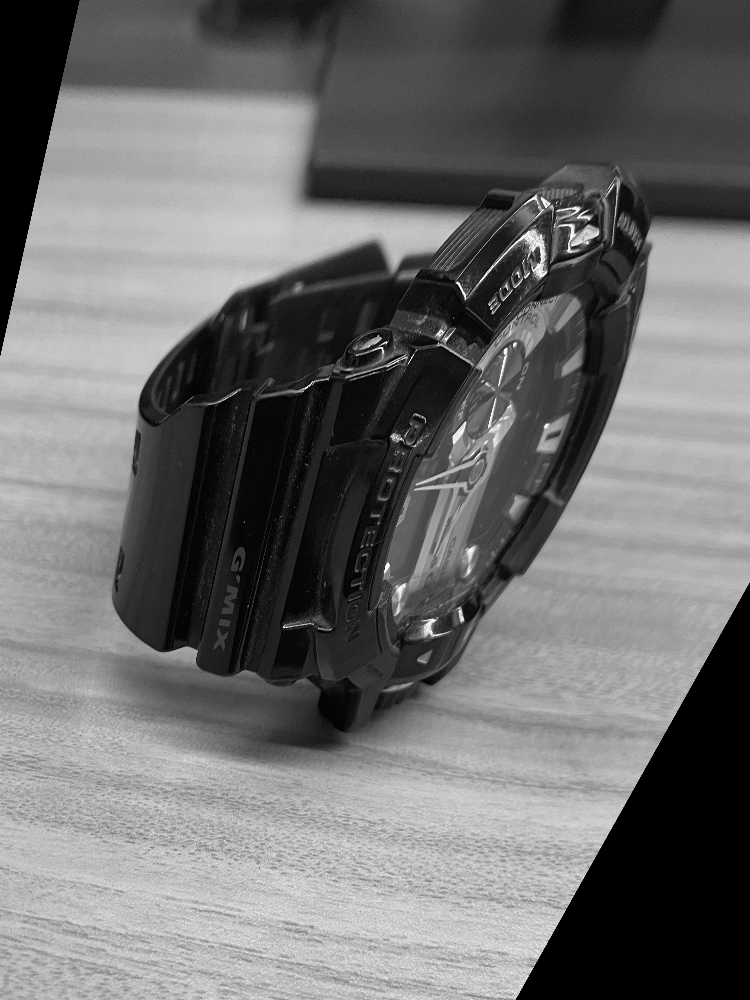

In [ ]:
#perform prespective transform

M,_ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

#Apply prespective transform

registered_image = cv2.warpPerspective(img1,M,(img2.shape[1],img2.shape[0]))

cv2_imshow(registered_image)

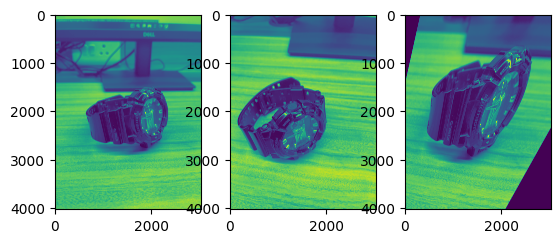

In [ ]:
plt.subplot(1,3,1)
plt.imshow(img1)
plt.subplot(1,3,2)
plt.imshow(img2)
plt.subplot(1,3,3)
plt.imshow(registered_image)